In [47]:
import itk
# print(itk.elastix_registration_method)

print("starting1")

%run "common_functions.py"

cy1_shifted_file = "orig_3x3.png"
cy2_shifted_file = "greyscale_shift.png"

fixed_image = itk.imread(cy1_shifted_file)[0:5000, 0:5000]
moving_image = itk.imread(cy2_shifted_file)[0:5000, 0:5000]
# nda = sitk.GetArrayFromImage(moving_image)
# imshow(nda)
# plt.savefig('foo.pdf')



starting1


In [48]:
def c(im):
    return Image.fromarray(im, 'L')
c(moving_image)

print(moving_image)

import stitch2d

[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...  71  63  62]
 [  0   0   0 ... 115  88  64]
 [  0   0   0 ... 154 115  70]]


In [49]:


print("All right!")


registered_image, params = itk.elastix_registration_method(fixed_image, moving_image)



# SimpleITK.ElastixImageFilter
# resultImage = SimpleITK.Elastix(fixed_image, moving_image)


All right!


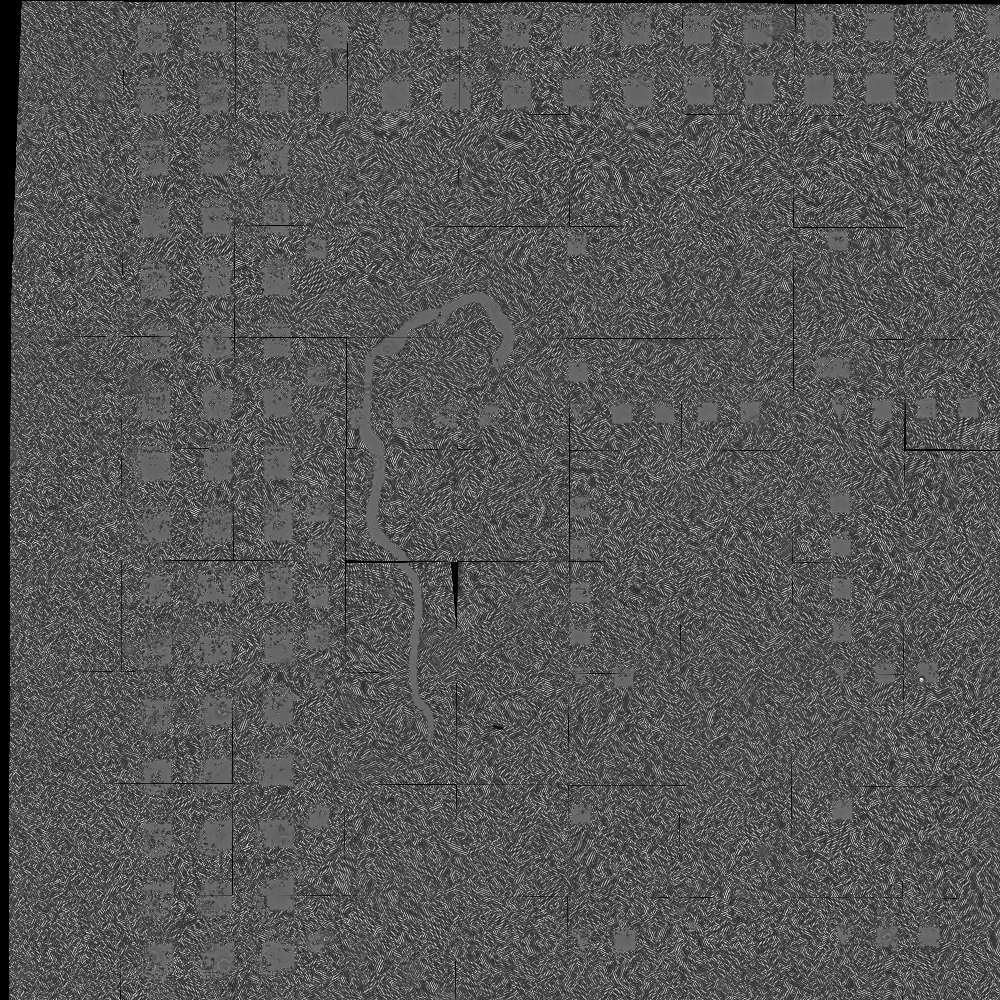

In [53]:
registered_image
from PIL import Image

img = Image.fromarray(moving_image, 'L')
img

In [ ]:
initial_transform = sitk.CenteredTransformInitializer(
    fixed_image,
    moving_image,
    sitk.Euler2DTransform(),
    sitk.CenteredTransformInitializerFilter.GEOMETRY,
)

NameError: name 'sitk' is not defined

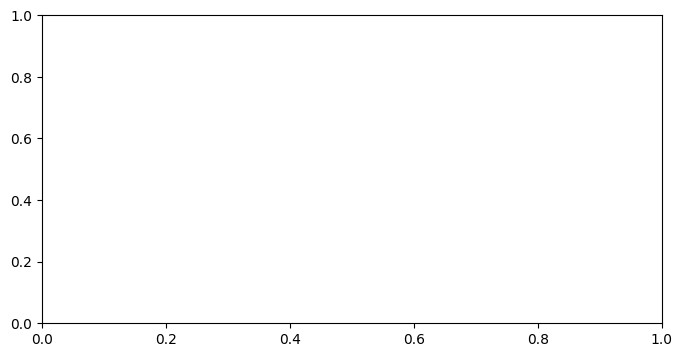

Final metric value: -0.019816400556766468
Optimizer's stopping condition, GradientDescentOptimizerv4Template: Convergence checker passed at iteration 23.


In [ ]:
registration_method = sitk.ImageRegistrationMethod()

# Similarity metric settings.
registration_method.SetMetricAsMattesMutualInformation(numberOfHistogramBins=50)
registration_method.SetMetricSamplingStrategy(registration_method.RANDOM)
registration_method.SetMetricSamplingPercentage(.1)

registration_method.SetInterpolator(sitk.sitkLinear)

registration_method.SetOptimizerAsGradientDescent(learningRate=1.0, numberOfIterations=1000, convergenceMinimumValue=1e-8, convergenceWindowSize=10)
registration_method.SetOptimizerScalesFromPhysicalShift()


registration_method.SetInitialTransform(initial_transform, inPlace=False)

registration_method.AddCommand(sitk.sitkStartEvent, rgui.start_plot)
registration_method.AddCommand(sitk.sitkEndEvent, rgui.end_plot)
registration_method.AddCommand(sitk.sitkMultiResolutionIterationEvent, rgui.update_multires_iterations) 
registration_method.AddCommand(sitk.sitkIterationEvent, lambda: rgui.plot_values(registration_method))

final_transform = registration_method.Execute(fixed_image, moving_image)

# Always check the reason optimization terminated.
print('Final metric value: {0}'.format(registration_method.GetMetricValue()))
print('Optimizer\'s stopping condition, {0}'.format(registration_method.GetOptimizerStopConditionDescription()))

# print(final_transform)


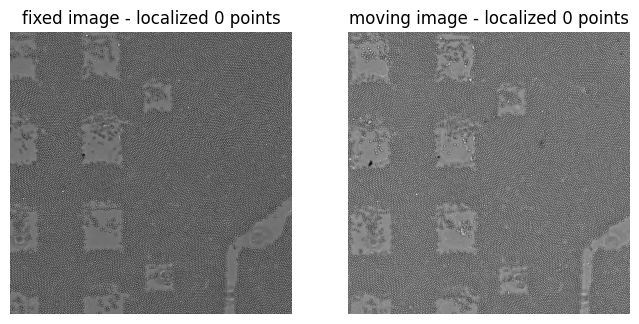

In [ ]:
import gui
gui.RegistrationPointDataAquisition(fixed_image, moving_image, figure_size=(8,4), known_transformation=final_transform)